In [ ]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats.mstats import winsorize
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import time
import warnings

warnings.filterwarnings("ignore")
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)
sns.set_palette("Set2")
sns.set_style("ticks")

In [ ]:
train_value = pd.read_csv('train_values.csv')
df_test = pd.read_csv('test_values.csv')
train_labels = pd.read_csv('train_labels.csv')


In [ ]:
train_value.head()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,802906,6,487,12198,2,30,6,5,t,r,n,f,q,t,d,1,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
1,28830,8,900,2812,2,10,8,7,o,r,n,x,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
2,94947,21,363,8973,2,10,5,5,t,r,n,f,x,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
3,590882,22,418,10694,2,10,6,5,t,r,n,f,x,s,d,0,1,0,0,0,0,1,1,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
4,201944,11,131,1488,3,30,8,9,t,r,n,f,x,s,d,1,0,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
train_labels.head()

,building_id,damage_grade
0,802906,3
1,28830,2
2,94947,3
3,590882,2
4,201944,3


In [ ]:
# convert_features = ["land_surface_condition","foundation_type", "roof_type", "ground_floor_type", "other_floor_type","position", "plan_configuration", "legal_ownership_status"]
# def convert(df,features):
#   for feature in features:
#     df[feature] = df[feature].astype("category")
# convert(df_train,convert_features)
# convert(df_test,convert_features)

## **Kiểu dữ liệu**

In [ ]:
train_value.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260601 entries, 0 to 260600
Data columns (total 39 columns):
 #   Column                                  Non-Null Count   Dtype 
---  ------                                  --------------   ----- 
 0   building_id                             260601 non-null  int64 
 1   geo_level_1_id                          260601 non-null  int64 
 2   geo_level_2_id                          260601 non-null  int64 
 3   geo_level_3_id                          260601 non-null  int64 
 4   count_floors_pre_eq                     260601 non-null  int64 
 5   age                                     260601 non-null  int64 
 6   area_percentage                         260601 non-null  int64 
 7   height_percentage                       260601 non-null  int64 
 8   land_surface_condition                  260601 non-null  object
 9   foundation_type                         260601 non-null  object
 10  roof_type                               260601 non-null 

In [ ]:
train_labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260601 entries, 0 to 260600
Data columns (total 2 columns):
 #   Column        Non-Null Count   Dtype
---  ------        --------------   -----
 0   building_id   260601 non-null  int64
 1   damage_grade  260601 non-null  int64
dtypes: int64(2)
memory usage: 4.0 MB


In [ ]:
train_value.describe()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
count,2.606010e+05,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000
mean,5.256755e+05,13.900353,701.074685,6257.876148,2.129723,26.535029,8.018051,5.434365,0.088645,0.761935,0.034332,0.018235,0.068154,0.075268,0.254988,0.085011,0.042590,0.015859,0.014985,0.983949,0.111880,0.064378,0.033626,0.008101,0.000940,0.000361,0.001071,0.000188,0.000146,0.000088,0.005119
std,3.045450e+05,8.033617,412.710734,3646.369645,0.727665,73.565937,4.392231,1.918418,0.284231,0.425900,0.182081,0.133800,0.252010,0.263824,0.435855,0.278899,0.201931,0.124932,0.121491,0.418389,0.315219,0.245426,0.180265,0.089638,0.030647,0.018989,0.032703,0.013711,0.012075,0.009394,0.071364
min,4.000000e+00,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.611900e+05,7.000000,350.000000,3073.000000,2.000000,10.000000,5.000000,4.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5.257570e+05,12.000000,702.000000,6270.000000,2.000000,15.000000,7.000000,5.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,7.897620e+05,21.000000,1050.000000,9412.000000,2.000000,30.000000,9.000000,6.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.052934e+06,30.000000,1427.000000,12567.000000,9.000000,995.000000,100.000000,32.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,9.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## **Missing Values**

In [ ]:
train_value.isnull().sum()

building_id                               0
geo_level_1_id                            0
geo_level_2_id                            0
geo_level_3_id                            0
count_floors_pre_eq                       0
age                                       0
area_percentage                           0
height_percentage                         0
land_surface_condition                    0
foundation_type                           0
roof_type                                 0
ground_floor_type                         0
other_floor_type                          0
position                                  0
plan_configuration                        0
has_superstructure_adobe_mud              0
has_superstructure_mud_mortar_stone       0
has_superstructure_stone_flag             0
has_superstructure_cement_mortar_stone    0
has_superstructure_mud_mortar_brick       0
has_superstructure_cement_mortar_brick    0
has_superstructure_timber                 0
has_superstructure_bamboo       

In [ ]:
train_labels.isnull().sum()

building_id     0
damage_grade    0
dtype: int64

In [ ]:
df_test.isnull().sum()

building_id                               0
geo_level_1_id                            0
geo_level_2_id                            0
geo_level_3_id                            0
count_floors_pre_eq                       0
age                                       0
area_percentage                           0
height_percentage                         0
land_surface_condition                    0
foundation_type                           0
roof_type                                 0
ground_floor_type                         0
other_floor_type                          0
position                                  0
plan_configuration                        0
has_superstructure_adobe_mud              0
has_superstructure_mud_mortar_stone       0
has_superstructure_stone_flag             0
has_superstructure_cement_mortar_stone    0
has_superstructure_mud_mortar_brick       0
has_superstructure_cement_mortar_brick    0
has_superstructure_timber                 0
has_superstructure_bamboo       

Dữ liệu khá clean

## **Phân tích dữ liệu**

In [ ]:
train_value= train_value.merge(train_labels, on='building_id')

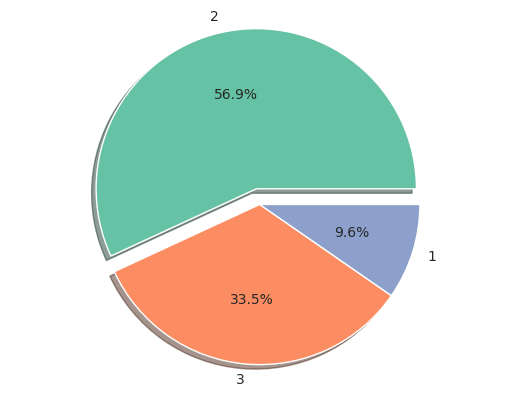

In [ ]:
percent = list(train_value['damage_grade'].value_counts()/len(train_value['damage_grade'])*100)
label = list(train_value['damage_grade'].value_counts().index)
explode = (0.1,0,0)
fig,ax1 = plt.subplots()
ax1.pie(percent, explode=explode, labels=label, autopct='%1.1f%%',shadow=True)
ax1.axis('equal')
plt.show()

Có thể dễ dàng nhận thấy rằng tập dữ liệu rất mất cân bằng. Lý do khiến tập dữ liệu này mất cân bằng có thể là do dữ liệu được thu thập sau trận động đất ở Nepal năm 2015 và rất có thể mức độ thiệt hại của các tòa nhà có mối tương quan cao với cường độ của trận động đất.

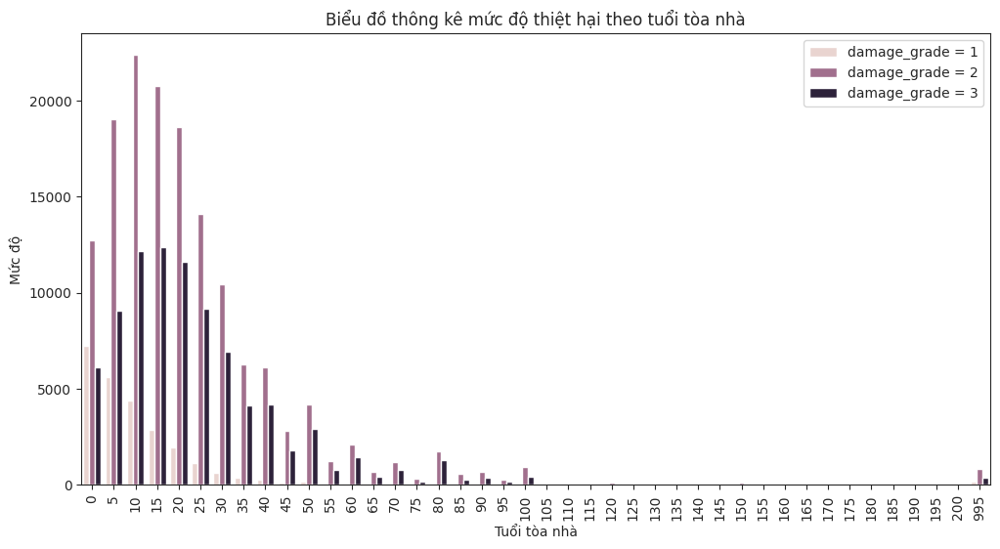

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x=train_value["age"],hue=train_labels["damage_grade"])
plt.ylabel("Mức độ")
plt.xlabel("Tuổi tòa nhà")
plt.xticks(rotation=90)
plt.title("Biểu đồ thông kê mức độ thiệt hại theo tuổi tòa nhà")
plt.legend(["damage_grade = 1","damage_grade = 2","damage_grade = 3"])
plt.show()

Ta có thể thấy rằng xuất hiện những tòa nhà 995 năm tuổi khá cũ, tuy nhiên từ khoảng 105-200 gần như không có số liệu, cho nên ta cần xử lí các ngoại lệ này, damage_grade 2 xuất hiện cao nhất ở những toà nhà dao động từ 5-20 tuổi

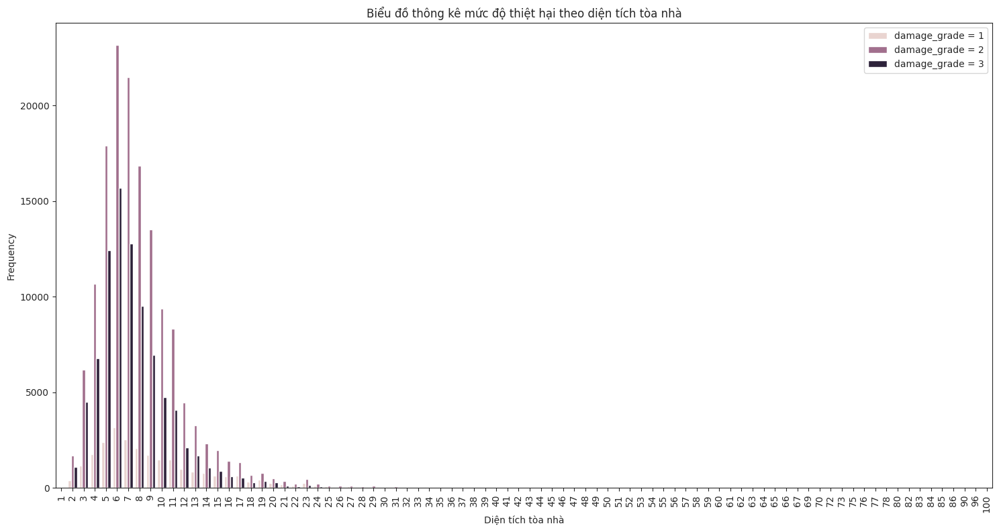

In [ ]:
plt.figure(figsize=(18,9))
sns.countplot(x=train_value["area_percentage"],hue=train_labels["damage_grade"])
plt.ylabel("Frequency")
plt.xlabel("Diện tích tòa nhà")
plt.xticks(rotation=90)
plt.title("Biểu đồ thông kê mức độ thiệt hại theo diện tích tòa nhà")
plt.legend(["damage_grade = 1","damage_grade = 2","damage_grade = 3"])
plt.show()

Diện tích tiêu chuẩn của diện tích tòa nhà là dưới 20% đối với hầu hết các tòa nhà, cần ngoại lệ các con số từ 20 đổ lên

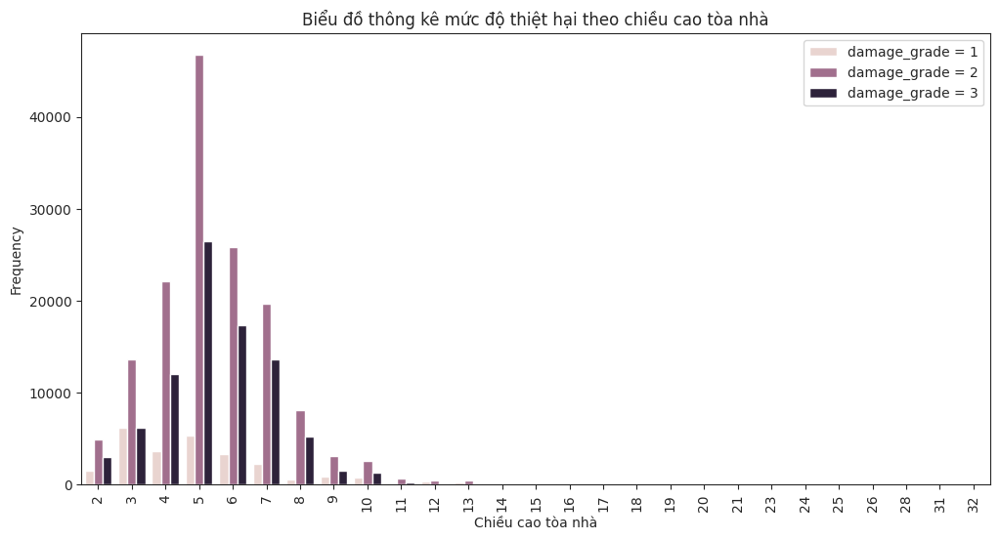

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x=train_value["height_percentage"],hue=train_labels["damage_grade"])
plt.ylabel("Frequency")
plt.xlabel("Chiều cao tòa nhà")
plt.xticks(rotation=90)
plt.title("Biểu đồ thông kê mức độ thiệt hại theo chiều cao tòa nhà")
plt.legend(["damage_grade = 1","damage_grade = 2","damage_grade = 3"])
plt.show()

Hầu hết dữ liệu cho chiều cao tòa nhà nhỏ hơn 10% nhưng chỉ có một số ít tòa nhà có giá trị lên tới 32%.

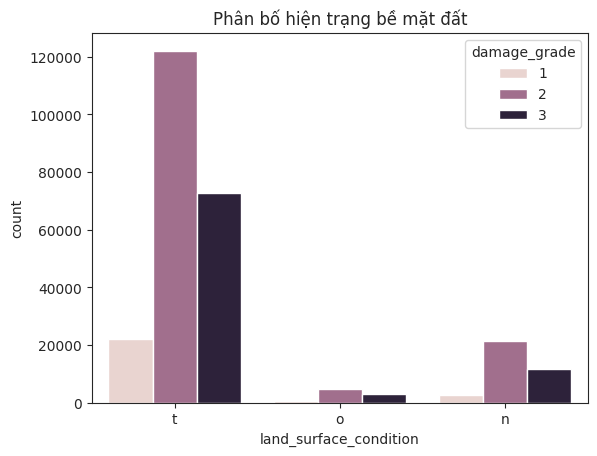

In [ ]:
sns.countplot(x = train_value["land_surface_condition"], hue = train_labels["damage_grade"])
plt.title("Phân bố hiện trạng bề mặt đất")
plt.show()

Đây là một biến phân loại cho biết tình trạng bề mặt của đất nơi tòa nhà được xây dựng. Các giá trị có thể có: n, o, t.

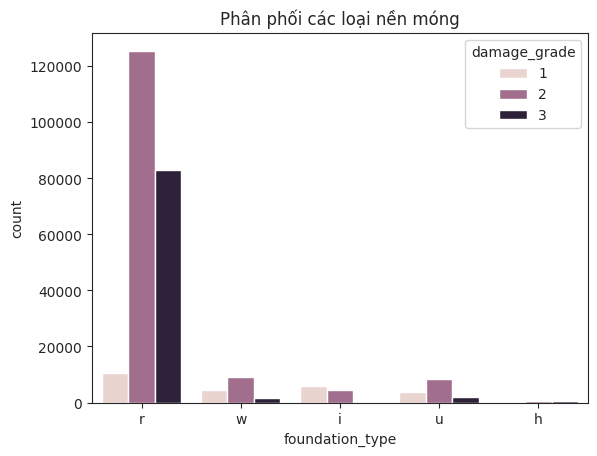

In [ ]:
sns.countplot(x = train_value["foundation_type"], hue = train_labels["damage_grade"])
plt.title("Phân phối các loại nền móng")
plt.show()

Đây là một biến phân loại cho biết loại nền móng được sử dụng khi xây dựng. Các giá trị có thể có: h, i, r, u, w.

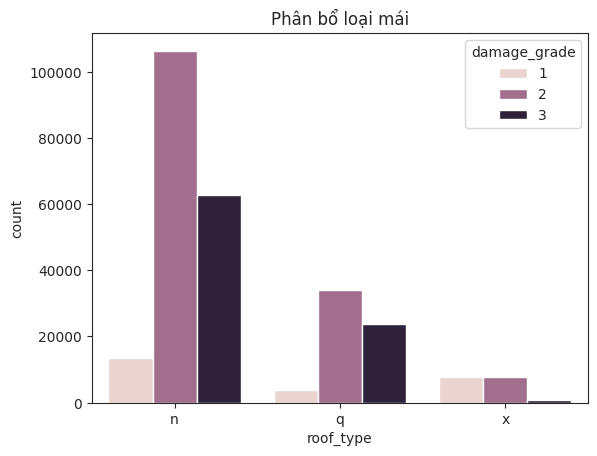

In [ ]:
sns.countplot(x = train_value["roof_type"], hue = train_labels["damage_grade"])
plt.title("Phân bổ loại mái")
plt.show()

Đây là một biến phân loại cho biết loại mái được sử dụng khi xây dựng. Các giá trị có thể có: n, q, x

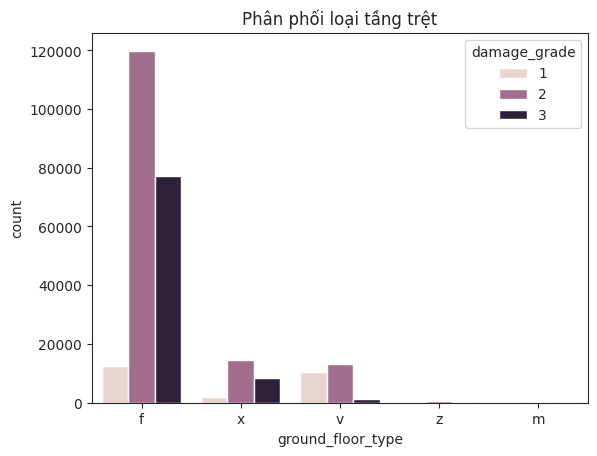

In [ ]:
sns.countplot(x = train_value["ground_floor_type"], hue = train_labels["damage_grade"])
plt.title("Phân phối loại tầng trệt")
plt.show()

Đây là một biến phân loại cho biết loại tầng trệt. Các giá trị có thể có: f, m, v, x, z.

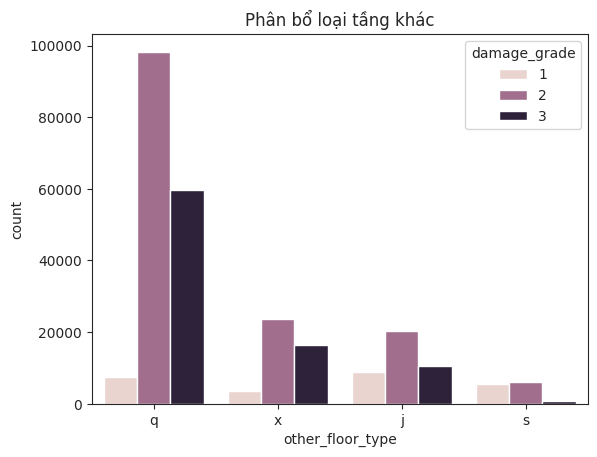

In [ ]:
sns.countplot(x = train_value["other_floor_type"], hue = train_labels["damage_grade"])
plt.title("Phân bổ loại tầng khác")
plt.show()

Đây là một biến phân loại cho biết loại công trình được sử dụng ở tầng cao hơn tầng trệt (trừ mái nhà). Các giá trị có thể có: j, q, s, x.

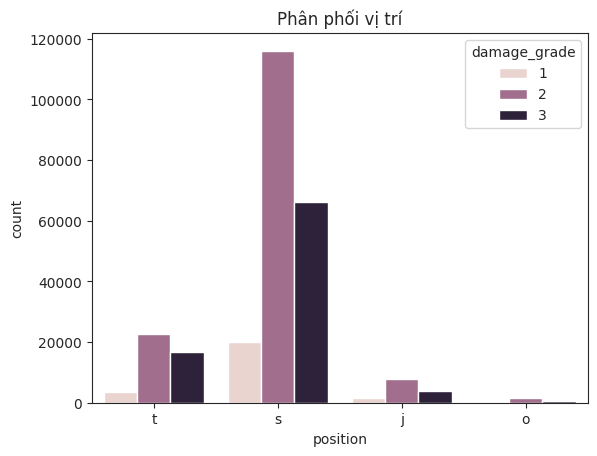

In [ ]:
sns.countplot(x = train_value["position"], hue = train_labels["damage_grade"])
plt.title("Phân phối vị trí")
plt.show()

Đây là một biến phân loại cho biết vị trí của tòa nhà. Các giá trị có thể có: j, o, s, t.

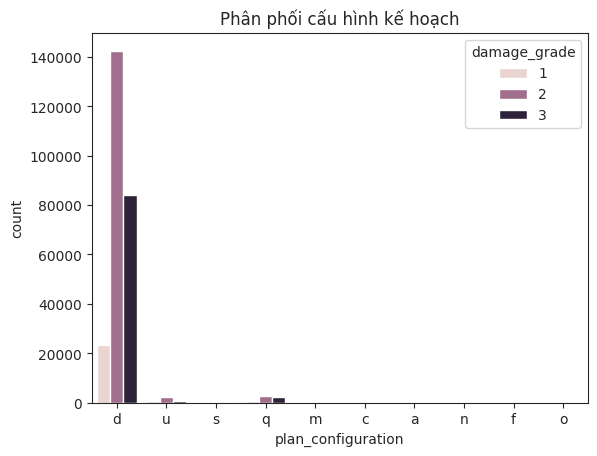

In [ ]:
sns.countplot(x = train_value["plan_configuration"], hue = train_labels["damage_grade"])
plt.title("Phân phối cấu hình kế hoạch")
plt.show()

Đây là một biến phân loại cho biết cấu hình kế hoạch xây dựng. Các giá trị có thể có: a, c, d, f, m, n, o, q, s, u.

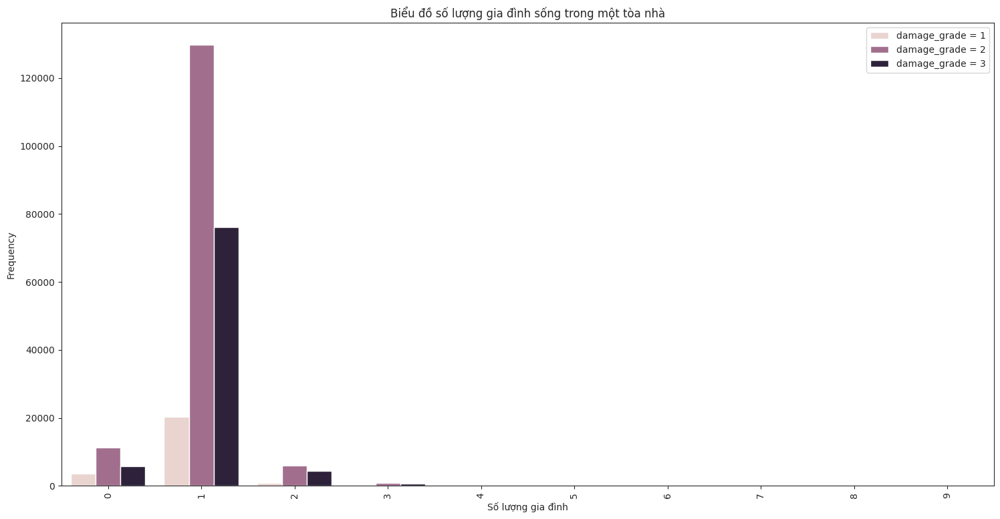

In [ ]:
plt.figure(figsize=(18,9))
sns.countplot(x=train_value["count_families"],hue=train_labels["damage_grade"])
plt.ylabel("Frequency")
plt.xlabel("Số lượng gia đình")
plt.xticks(rotation=90)
plt.title("Biểu đồ số lượng gia đình sống trong một tòa nhà")
plt.legend(["damage_grade = 1","damage_grade = 2","damage_grade = 3"])
plt.show()

Hầu hết các tòa nhà chỉ có 1 gia đình sống trong đó. Chúng tôi cũng có những tòa nhà có tới 9 gia đình đang sinh sống, những tòa nhà này có thể giống như những tòa nhà 9 tầng.

## **Ngoại lệ**


Random Forest là một mô hình học máy dựa trên cây quyết định (decision tree), được cho là hoạt động mạnh mẽ ngay cả khi dữ liệu chứa các giá trị ngoại lệ. Tuy nhiên, đây là quan niệm sai lầm phổ biến...

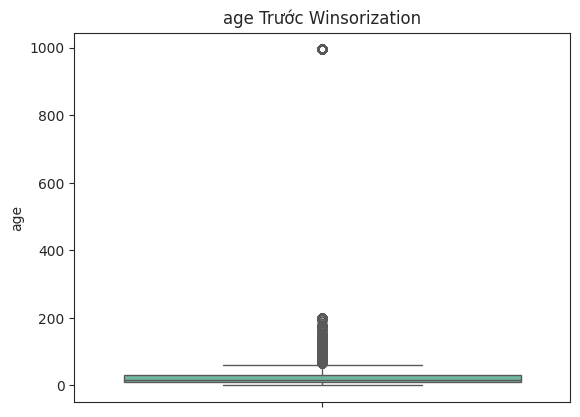

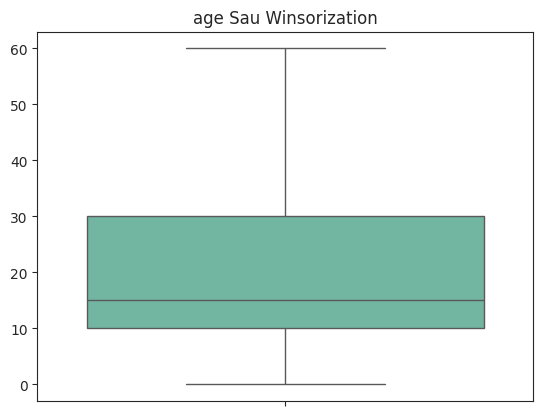

In [ ]:
#Data source
name = "age"
data = train_value[name]

#Trước winsorization
sns.boxplot(data)
plt.title("{} Trước Winsorization".format(name))
plt.show()

#Winsorization
winsorized_data = winsorize(data,(0, 0.05))

#Sau winsorization
sns.boxplot(winsorized_data)
plt.title("{} Sau Winsorization".format(name))
plt.show()

#Thay thế data trong dataset
train_value[name] = winsorized_data

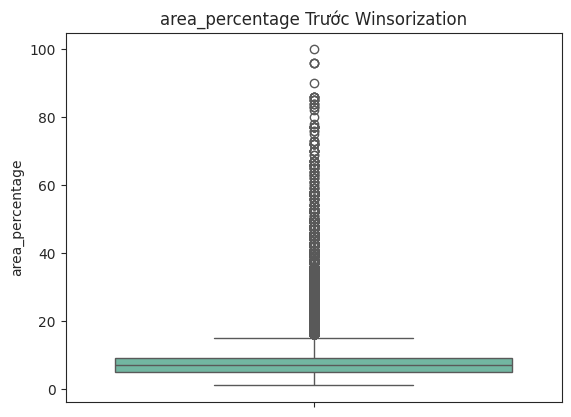

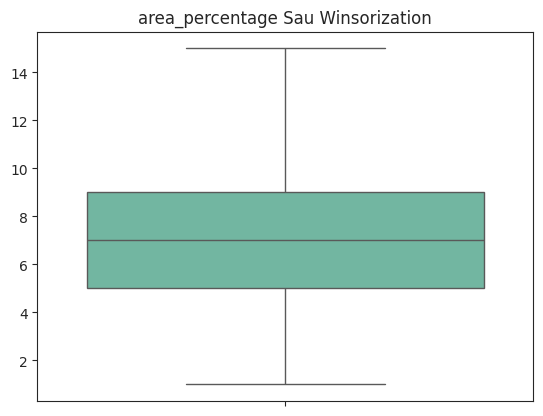

In [ ]:
#Data source
name = "area_percentage"
data = train_value[name]

#Trước winsorization
sns.boxplot(data)
plt.title("{} Trước Winsorization".format(name))
plt.show()

#Winsorization
winsorized_data = winsorize(data,(0, 0.055))

#Sau winsorization
sns.boxplot(winsorized_data)
plt.title("{} Sau Winsorization".format(name))
plt.show()

#Replace data in dataset
train_value[name] = winsorized_data

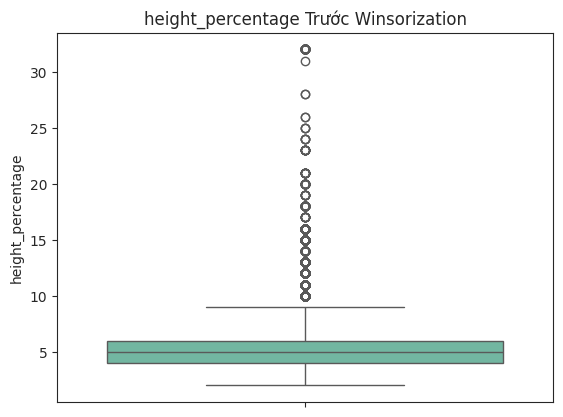

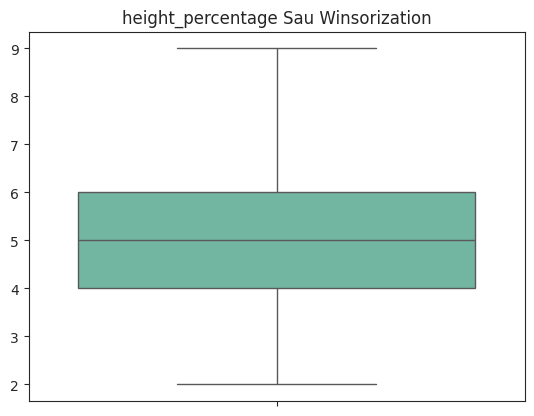

In [ ]:
#Data source
name = "height_percentage"
data = train_value[name]

#Trước winsorization
sns.boxplot(data)
plt.title("{} Trước Winsorization".format(name))
plt.show()

#Winsorization
winsorized_data = winsorize(data,(0, 0.04))

#Sau winsorization
sns.boxplot(winsorized_data)
plt.title("{} Sau Winsorization".format(name))
plt.show()

#Replace data in dataset
train_value[name] = winsorized_data

## **Sự tương quan**

In [ ]:
train_value.drop(columns=["building_id"], inplace=True)
train_value.drop(columns=["damage_grade"], inplace=True)
train_labels.drop(columns=["building_id"], inplace=True)

In [ ]:
train_labels.head()

,damage_grade
0,3
1,2
2,3
3,2
4,3


In [ ]:
train_values = pd.get_dummies(train_value, drop_first = True)

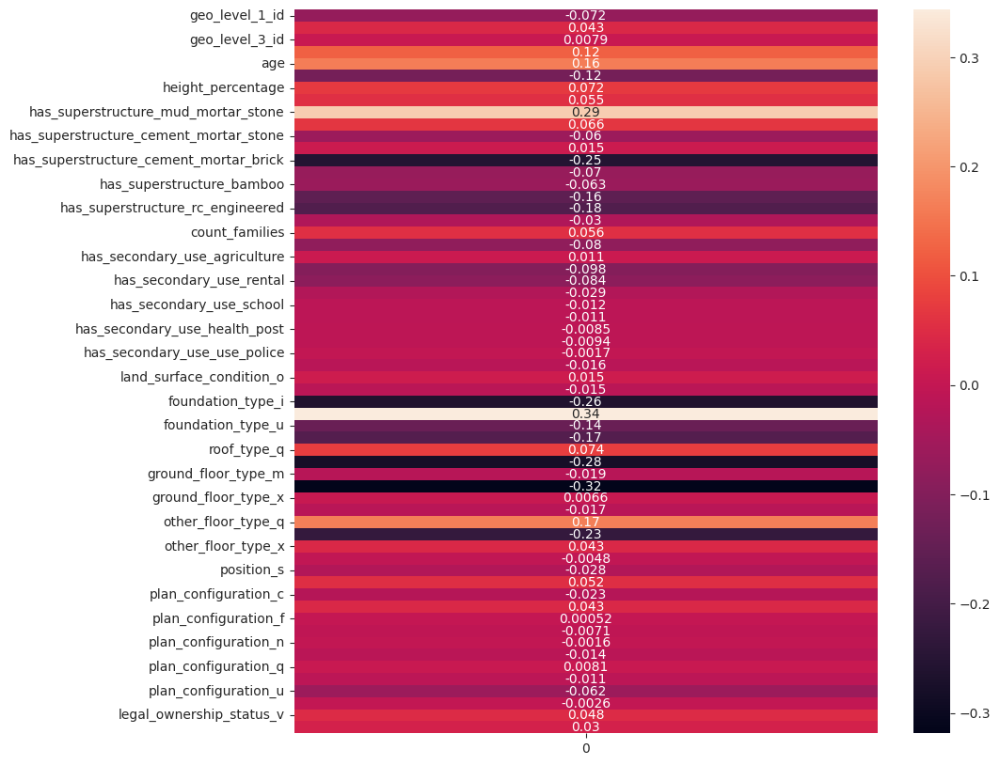

In [ ]:
plt.figure(figsize=(10,10))
correlations = train_values.corrwith(train_labels["damage_grade"])
sns.heatmap(pd.DataFrame(correlations), annot=True)
plt.show()

## **Câu 2: Hồi quy tuyến tính**

In [ ]:
X = train_values
y = train_labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score

# Tạo mô hình Linear Regression
model = LinearRegression()

# Huấn luyện mô hình
model.fit(X_train, y_train)

# Dự đoán
y_pred = model.predict(X_test)
y_pred_class = np.round(y_pred).astype(int)

# Tính độ chính xác
accuracy = accuracy_score(y_test, y_pred_class)

print("Accuracy:", accuracy)

Accuracy: 0.5747587344832218


## Nhận xét
Để có thể đo accuracy, ta phải chuẩn hóa lại y_pred bằng cách làm tròn dữ liệu để so sánh nhãn

Sử dụng độ chính xác (accuracy) để đánh giá mô hình Linear Regression không phải là cách tiếp cận tốt nhất vì:

1. *Linear Regression là mô hình hồi quy*: Mục tiêu của nó là dự đoán một giá trị liên tục, không phải phân loại các đối tượng vào các lớp. Do đó, việc sử dụng độ chính xác, một chỉ số thường được sử dụng cho các mô hình phân loại, không phản ánh chính xác hiệu suất của mô hình hồi quy.

2. *Giá trị độ chính xác 0.5747587344832218 chỉ ra rằng*: Khi chuyển đổi kết quả dự đoán từ mô hình hồi quy thành các lớp bằng cách làm tròn, chỉ có khoảng 57% dự đoán được phân loại chính xác. Tuy nhiên, con số này không cung cấp thông tin về mức độ sai lệch của các dự đoán so với giá trị thực tế trong bối cảnh hồi quy.

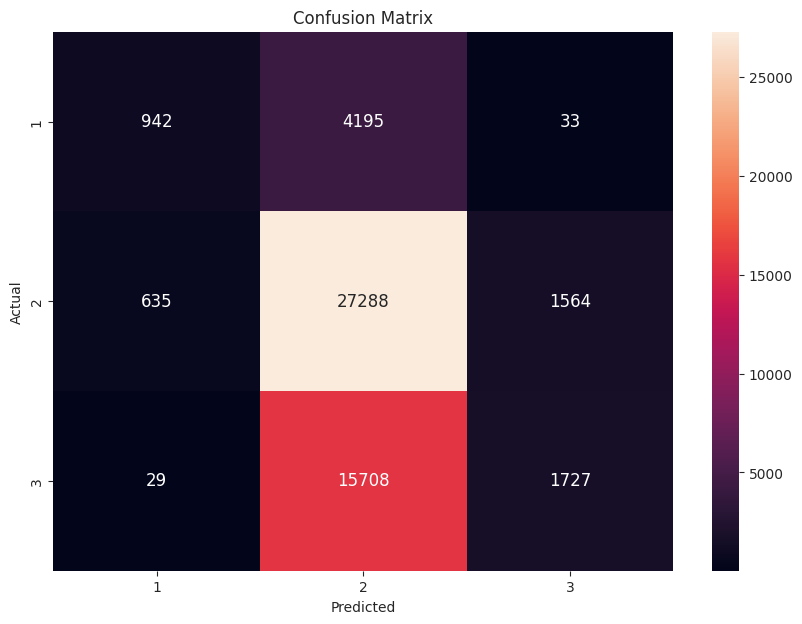

In [ ]:
from sklearn.metrics import confusion_matrix

data = confusion_matrix(y_test, y_pred_class)
cm = pd.DataFrame(data, columns=np.unique(y_test), index = np.unique(y_test))
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 12})
plt.title("Confusion Matrix")
plt.show()

## **Câu 3:**
### **a)**

In [ ]:
train_labels.head()

,damage_grade
0,3
1,2
2,3
3,2
4,3


In [ ]:
from sklearn.preprocessing import LabelEncoder

def changeLabel(df):
    label_encoder = LabelEncoder()

    # Fit label encoder vào các nhãn
    label_encoder.fit(df["damage_grade"])

    # Biến đổi các nhãn
    df["damage_class"] = label_encoder.transform(df["damage_grade"])

changeLabel(train_labels)


In [ ]:
train_labels.head()

,damage_grade,damage_class
0,3,2
1,2,1
2,3,2
3,2,1
4,3,2


In [ ]:
train_labels.drop(columns=["damage_grade"], inplace=True)


In [ ]:
from sklearn.model_selection import train_test_split

X = train_values
y = train_labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score
import time

# Tạo và huấn luyện mô hình Naïve Bayes
nb_model = GaussianNB()
# Đo thời gian chạy cho Naïve Bayes
start_time = time.time()
nb_model.fit(X_train, y_train)
nb_time = time.time() - start_time

print(f"Naïve Bayes Training Time: {nb_time} seconds")

# Dự đoán và đánh giá mô hình Naïve Bayes
nb_predictions = nb_model.predict(X_test)
nb_accuracy = accuracy_score(y_test, nb_predictions)
nb_precision = precision_score(y_test, nb_predictions, average="macro")
nb_recall = recall_score(y_test, nb_predictions, average="macro")

print(f"Naïve Bayes Accuracy: {nb_accuracy}")
print(f"Naïve Bayes Precision: {nb_precision}")
print(f"Naïve Bayes Recall: {nb_recall}")

Naïve Bayes Training Time: 0.5898945331573486 seconds
Naïve Bayes Accuracy: 0.43527560867980275
Naïve Bayes Precision: 0.5007960654944719
Naïve Bayes Recall: 0.530470751094987


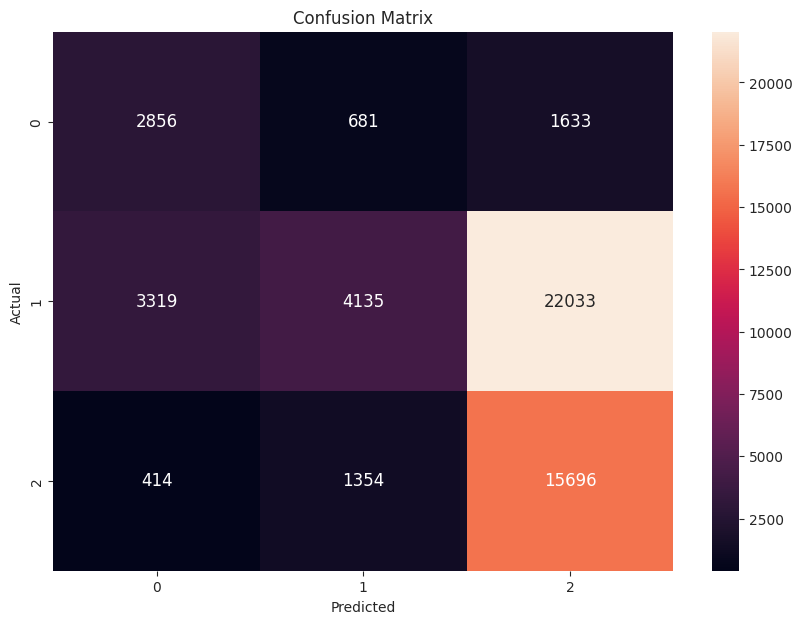

In [ ]:
data = confusion_matrix(y_test, nb_predictions)
cm = pd.DataFrame(data, columns=np.unique(y_test), index = np.unique(y_test))
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 12})
plt.title("Confusion Matrix")
plt.show()

In [ ]:
# Tạo và huấn luyện mô hình Multinomial Logistic Regression
logistic_model = LogisticRegression(solver='lbfgs', multi_class='multinomial', max_iter=1000)
start_time = time.time()
logistic_model.fit(X_train, y_train)
logistic_time = time.time() - start_time

print(f'Logistic Regression Training Time: {logistic_time} seconds')

# Dự đoán và đánh giá mô hình Logistic Regression
logistic_predictions = logistic_model.predict(X_test)
logistic_accuracy = accuracy_score(y_test, logistic_predictions)
logistic_precision = precision_score(y_test, logistic_predictions, average='macro')
logistic_recall = recall_score(y_test, logistic_predictions, average='macro')

print(f'Multinomial Logistic Regression Accuracy: {logistic_accuracy}')
print(f'Multinomial Logistic Regression Precision: {logistic_precision}')
print(f'Multinomial Logistic Regression Recall: {logistic_recall}')

Logistic Regression Training Time: 102.65093636512756 seconds
Multinomial Logistic Regression Accuracy: 0.5726674469024002
Multinomial Logistic Regression Precision: 0.5424536341393073
Multinomial Logistic Regression Recall: 0.41319087609271005


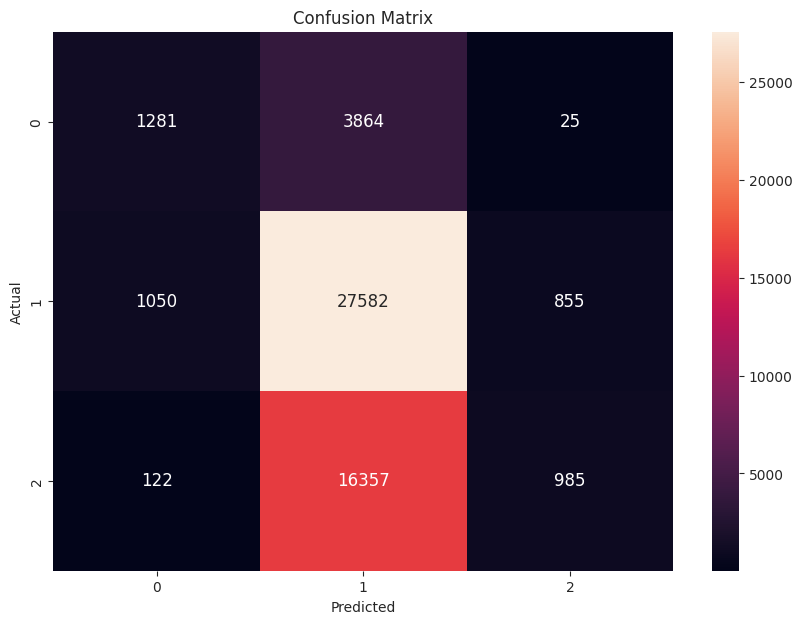

In [ ]:
data = confusion_matrix(y_test, logistic_predictions)
cm = pd.DataFrame(data, columns=np.unique(y_test), index = np.unique(y_test))
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 12})
plt.title("Confusion Matrix")
plt.show()

Một cách tổng quan, ta có thể thấy:

• Cả hai mô hình đều cho thấy hiệu suất tương đối tốt trong việc phân loại dữ liệu, nhưng Multinomial Logistic Regression có vẻ hiệu quả hơn so với Naïve Bayes. Tuy nhiên cả hai mô hình chưa thực sự được tối ưu cao.

• Mô hình Multinomial Logistic Regression có độ chính xác trên tập validation là khoảng 57.1%, đồng nghĩa với việc mô hình đưa ra dự đoán chính xác cho khoảng hơn một nửa số lượng mẫu trong tập dữ liệu kiểm định. Trong khi đó, đọ chính xác trên tập validation của mô hình Naïve Bayes là khoảng 43.52%. Do đó, ta nhận thấy mô hình Multinomial Logistic Regression cho thấy một sự cải thiện đáng kể trong việc phân loại nhưng đồng thời cũng khiến thời gian chạy lâu hơn đáng kể.

• Sự cải thiện của mô hình Multinomial Logistic Regression có thể được giải thích bởi cách mà nó xử lý các dữ liệu số
học và tập dữ liệu lớn.

## **b)**


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [ ]:
train_values_df = pd.read_csv('train_values.csv')
train_labels_df = pd.read_csv('train_labels.csv')
test_values_df = pd.read_csv('test_values.csv')
train_labels_df.drop('damage_grade',axis=1)

,building_id
0,802906
1,28830
2,94947
3,590882
4,201944
5,333020
6,728451
7,475515
8,441126
9,989500


In [ ]:
from sklearn.preprocessing import LabelEncoder

def convert(df):
    string_columns = [i for i, dtype in enumerate(df.dtypes) if dtype == 'object']

    # Chuyển đổi các giá trị string thành số nguyên
    label_encoders = []
    for col in string_columns:
        label_encoder = LabelEncoder()
        df.iloc[:, col] = label_encoder.fit_transform(df.iloc[:, col])
        label_encoders.append(label_encoder)

convert(train_values_df)
convert(test_values_df)

In [ ]:
combined_data = pd.concat([train_values_df, test_values_df], axis=0)
print(combined_data.shape)

(347469, 39)


In [ ]:
scaler = StandardScaler()
combined_data_scaled = scaler.fit_transform(combined_data)

In [ ]:
pca = PCA(n_components=10)
combined_data_pca = pca.fit_transform(combined_data_scaled)

In [ ]:
# Tách lại tập dữ liệu tổng hợp thành train_values_pca và test_values_pca
train_values_pca = combined_data_pca[:train_values.shape[0], :]
test_values_pca = combined_data_pca[train_values.shape[0]:, :]

In [ ]:
print(train_values_pca.shape)
print(test_values_pca.shape)

(260601, 10)
(86868, 10)


In [ ]:
# Tạo biến target
y = train_labels_df['damage_grade']

# Chia dữ liệu thành tập huấn luyện và tập kiểm tra
X_train, X_valid, y_train, y_valid = train_test_split(train_values_df, y, test_size=0.2, random_state=42)
X_train_pca, X_valid_pca, y_train_pca, y_valid_pca = train_test_split(train_values_pca, y, test_size=0.2, random_state=42)

In [ ]:
import pandas as pd
from tabulate import tabulate

# Huấn luyện và đánh giá mô hình Naive Bayes trên dữ liệu nguyên bản
nb = GaussianNB()
nb.fit(X_train, y_train)
y_pred_nb = nb.predict(X_valid)

# Tính toán các chỉ số đánh giá cho dữ liệu nguyên bản
accuracy_nb = accuracy_score(y_valid, y_pred_nb)
precision_nb = precision_score(y_valid, y_pred_nb, average='weighted')
recall_nb = recall_score(y_valid, y_pred_nb, average='weighted')

# Huấn luyện và đánh giá mô hình Naive Bayes trên dữ liệu đã giảm chiều
nb_pca = GaussianNB()
nb_pca.fit(X_train_pca, y_train)
y_pred_nb_pca = nb_pca.predict(X_valid_pca)

# Tính toán các chỉ số đánh giá cho dữ liệu đã giảm chiều
accuracy_nb_pca = accuracy_score(y_valid_pca, y_pred_nb_pca)
precision_nb_pca = precision_score(y_valid_pca, y_pred_nb_pca, average='weighted')
recall_nb_pca = recall_score(y_valid_pca, y_pred_nb_pca, average='weighted')

# Tạo DataFrame để hiển thị bảng so sánh
data = {
    'Chỉ số Đánh Giá': ['Độ Chính Xác (Accuracy)', 'Độ Chính Xác Tích Cực (Precision)', 'Độ Nhạy (Recall)'],
    'Dữ Liệu Nguyên Bản': [accuracy_nb, precision_nb, recall_nb],
    'Dữ Liệu Đã Giảm Chiều (PCA)': [accuracy_nb_pca, precision_nb_pca, recall_nb_pca]
}

df = pd.DataFrame(data)

print(tabulate(df, headers='keys', tablefmt='pretty', showindex=False))

+-----------------------------------+---------------------+-----------------------------+
|          Chỉ số Đánh Giá          | Dữ Liệu Nguyên Bản  | Dữ Liệu Đã Giảm Chiều (PCA) |
+-----------------------------------+---------------------+-----------------------------+
|      Độ Chính Xác (Accuracy)      | 0.5629784539820801  |     0.46768097312023943     |
| Độ Chính Xác Tích Cực (Precision) | 0.33156245520907485 |     0.5128850533293079      |
|         Độ Nhạy (Recall)          | 0.5629784539820801  |     0.46768097312023943     |
+-----------------------------------+---------------------+-----------------------------+


In [ ]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score

# Huấn luyện và đánh giá mô hình Multinomial Logistic trên dữ liệu nguyên bản
lr = LogisticRegression(multi_class='multinomial', max_iter=1000)
lr.fit(X_train, y_train)
y_pred_lr = lr.predict(X_valid)

# Tính toán các chỉ số đánh giá cho dữ liệu nguyên bản
accuracy_lr = accuracy_score(y_valid, y_pred_lr)
precision_lr = precision_score(y_valid, y_pred_lr, average='weighted')
recall_lr = recall_score(y_valid, y_pred_lr, average='weighted')

# Huấn luyện và đánh giá mô hình Multinomial Logistic trên dữ liệu đã giảm chiều
lr_pca = LogisticRegression(multi_class='multinomial', max_iter=1000)
lr_pca.fit(X_train_pca, y_train)
y_pred_lr_pca = lr_pca.predict(X_valid_pca)

# Tính toán các chỉ số đánh giá cho dữ liệu đã giảm chiều
accuracy_lr_pca = accuracy_score(y_valid_pca, y_pred_lr_pca)
precision_lr_pca = precision_score(y_valid_pca, y_pred_lr_pca, average='weighted')
recall_lr_pca = recall_score(y_valid_pca, y_pred_lr_pca, average='weighted')

# Tạo DataFrame để hiển thị bảng so sánh
data = {
    'Chỉ số Đánh Giá': ['Độ Chính Xác (Accuracy)', 'Độ Chính Xác Tích Cực (Precision)', 'Độ Nhạy (Recall)'],
    'Dữ Liệu Nguyên Bản': [accuracy_lr, precision_lr, recall_lr],
    'Dữ Liệu Đã Giảm Chiều (PCA)': [accuracy_lr_pca, precision_lr_pca, recall_lr_pca]
}

df = pd.DataFrame(data)

print(tabulate(df, headers='keys', tablefmt='pretty', showindex=False))

+-----------------------------------+--------------------+-----------------------------+
|          Chỉ số Đánh Giá          | Dữ Liệu Nguyên Bản | Dữ Liệu Đã Giảm Chiều (PCA) |
+-----------------------------------+--------------------+-----------------------------+
|      Độ Chính Xác (Accuracy)      | 0.5657412559237159 |      0.569175572226166      |
| Độ Chính Xác Tích Cực (Precision) | 0.3200631686541435 |     0.5421791593376573      |
|         Độ Nhạy (Recall)          | 0.5657412559237159 |      0.569175572226166      |
+-----------------------------------+--------------------+-----------------------------+


## **c)**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split

# Giả sử bạn đã có các biến train_values_pca, test_values_pca, y
# y_encoded là dữ liệu nhãn đã được mã hóa one-hot
y_encoded = to_categorical(y - 1)
X_train, X_valid, y_train, y_valid = train_test_split(train_values_pca, y_encoded, test_size=0.2, random_state=42)

# Xây dựng mô hình mạng neural
model = Sequential()
model.add(Dense(64, input_dim=10, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(3, activation='softmax'))  # Giả sử có 3 mức độ thiệt hại

# Compile mô hình
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Huấn luyện mô hình
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_valid, y_valid))

# Đánh giá mô hình
y_valid_pred = model.predict(X_valid)
y_valid_pred_classes = y_valid_pred.argmax(axis=1) + 1
y_valid_true_classes = y_valid.argmax(axis=1) + 1

accuracy = accuracy_score(y_valid_true_classes, y_valid_pred_classes)
precision = precision_score(y_valid_true_classes, y_valid_pred_classes, average='weighted')
recall = recall_score(y_valid_true_classes, y_valid_pred_classes, average='weighted')

print(f'Neural Network accuracy on PCA data: {accuracy}')
print(f'Neural Network precision on PCA data: {precision}')
print(f'Neural Network recall on PCA data: {recall}')

# Dự đoán trên test data
test_predictions = model.predict(test_values_pca)
test_predictions_classes = test_predictions.argmax(axis=1) + 1

Epoch 1/50
6515/6515 [==============================] - 17s 2ms/step - loss: 0.8007 - accuracy: 0.5912 - val_loss: 0.7922 - val_accuracy: 0.6005
Epoch 2/50
6515/6515 [==============================] - 15s 2ms/step - loss: 0.7866 - accuracy: 0.6012 - val_loss: 0.7872 - val_accuracy: 0.6032
Epoch 3/50
6515/6515 [==============================] - 14s 2ms/step - loss: 0.7819 - accuracy: 0.6056 - val_loss: 0.7838 - val_accuracy: 0.6066
Epoch 4/50
6515/6515 [==============================] - 15s 2ms/step - loss: 0.7790 - accuracy: 0.6081 - val_loss: 0.7815 - val_accuracy: 0.6101
Epoch 5/50
6515/6515 [==============================] - 15s 2ms/step - loss: 0.7762 - accuracy: 0.6112 - val_loss: 0.7816 - val_accuracy: 0.6089
Epoch 6/50
6515/6515 [==============================] - 15s 2ms/step - loss: 0.7740 - accuracy: 0.6131 - val_loss: 0.7772 - val_accuracy: 0.6163
Epoch 7/50
6515/6515 [==============================] - 16s 2ms/step - loss: 0.7718 - accuracy: 0.6150 - val_loss: 0.7780 - val_ac

In [ ]:
# Lưu kết quả dự đoán
submission = pd.DataFrame({'building_id': test_values_df['building_id'], 'damage_grade': test_predictions_classes})
submission.to_csv('submission.csv', index=False)

Dựa trên các kết quả nghiên cứu, có thể đưa ra một số nhận xét như sau:

1. Mô hình Neural Network (ANN) thường cho kết quả tốt hơn so với các mô hình truyền thống như Naive Bayes hay Logistic Regression khi áp dụng trên dữ liệu đã qua giảm chiều PCA. Nguyên nhân là do ANN có khả năng học các mối quan hệ phi tuyến phức tạp trong dữ liệu tốt hơn.

2. Mặc dù giảm chiều PCA giúp giảm số lượng tham số của mô hình và tăng tốc huấn luyện, nhưng nếu giảm quá mức sẽ phản tác dụng do mất mát thông tin. Cần cân bằng giữa tốc độ và độ chính xác khi lựa chọn số chiều phù hợp.

3. Các mô hình đơn giản như Naive Bayes, Logistic có xu hướng bị ảnh hưởng nhiều hơn bởi việc giảm chiều PCA so với các mô hình phức tạp như Neural Network. Do đó, với những mô hình này, chỉ nên áp dụng PCA với mức độ vừa phải.

## **Câu 4:**

In [ ]:
linear_regress_predictions = pd.DataFrame(y_pred_class, columns=['damage_grade'])


In [ ]:
linear_regress_predictions.head()

,damage_grade
0,2
1,2
2,2
3,2
4,2


In [ ]:
changeLabel(linear_regress_predictions)


In [ ]:
linear_regress_predictions.drop(columns=["damage_grade"], inplace=True)


In [ ]:
linear_regress_predictions.shape

(52121, 1)

In [ ]:
logistic_predictions.shape

(52121,)

In [ ]:
# So sánh giữa các mô hình
accuracy1 = accuracy_score(linear_regress_predictions, logistic_predictions)
accuracy2 = accuracy_score(linear_regress_predictions, nb_predictions)

In [ ]:
accuracy1

0.8889123385967268

In [ ]:
accuracy2

0.20897526908539743

Qua quan sát, ta có thể thấy so với mô hình Liner Regress Predictions:

• Mô hình Multinomial Logistic Regression có độ chính xác là 90.53%.

• Mô hình Naive Bayes có độ chính xác là chỉ 20.90%.

Điều này có nghĩa là mô hình Multinomial Logistic Regression có khả năng dự đoán đúng cao hơn đáng kể so với mô hình Naïve Bayes trên tập dữ liệu được sử dụng để đánh giá. Điều này có thể do sự phức tạp của mô hình, cũng như sự phù hợp của nó với cấu trúc của dữ liệu. Trong khi đó, mô hình Naïve Bayes dường như không hoạt động hiệu quả trên tập dữ liệu này.